In [1]:
#Henter pakker 
import matplotlib.pyplot as plt 
import numpy as np 
from scipy.fft import fft, ifft 
plt.rcParams['figure.dpi'] = 125 #Sætter opløsning af figurer


# Dybden af potentialet
V0 = 1.5

# Bredden af potentialet
a = 2

# Parametre for Psi(0,x)
x0 = -15
sigma = 5
k0 = 2

#Define constants and variables 
dx = 0.01
x = np.arange(-30,30+dx,0.01, dtype=np.complex64)
dt = 1*10**(-3)
ts = np.arange(0,22,dt, dtype=np.complex64)

hbar = 1
m = 1
w = 1
N = len(x) #skal være længden af x

dp = 2*np.pi/(N*dx)
pmax = N*dp/2
pl = -pmax
p = np.arange(pl,-pl,dp, dtype=np.complex64)

xl = -10  #det laveste x vi har
n = np.arange(N)

#Bølgefunktion:
psi_x = np.exp(-.25*(x-x0)**2/sigma**2+1j*k0*x)
psi_x /= np.sqrt(np.trapz(np.abs(psi_x)**2, x))

# Og potentialet regnes, så vi kan plotte det nedenfor
V = np.zeros(np.size(x))
V[np.abs(x)<=a] = V0


#Fast fourier transform: 
f=psi_x*np.exp(-1j*pl*xl)*np.exp(-1j*pl*dx*n)
f_tilde = fft(f)

#Den potentielle og kinetiske: 
T=p**2/(2*m)

C:\Users\laura\anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


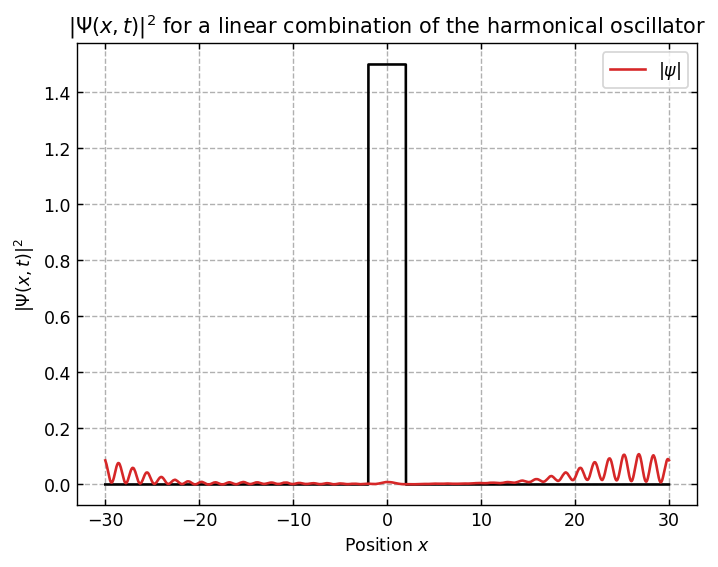

In [2]:
fig, axis = plt.subplots()

saved_steps = []

#loop hvor vi benytter andenordensudviklingen
for j,t in enumerate(ts): 
    f_tilde *= np.exp(-1j*dt*T/2)
    psi_x = ifft(f_tilde)
    psi_x *= np.exp(-1j*dt*V)
    f_tilde = fft(psi_x)                         
    f_tilde *= np.exp(-1j*dt*T/2)
    
    # Modulo
    if j % 100 == 0:
        saved_steps.append(ifft(f_tilde)*np.exp(1j*pl*xl)*np.exp(1j*pl*dx*n))

f = ifft(f_tilde)

psi_x_ny = f*np.exp(1j*pl*xl)*np.exp(1j*pl*dx*n) #"vender tilbage"

norm_psi = abs((psi_x_ny))**2       

#Plotter:
axis.plot(x, V, color='k')
axis.plot(x,norm_psi, ls = '-', color = 'tab:red', label=r'$|\psi|$')
axis.grid(ls='--')
axis.set_xlabel('Position $x$')
axis.set_ylabel('$|\Psi(x,t)|^2$')
axis.set_title('$|\Psi(x,t)|^2$ for a linear combination of the harmonical oscillator')
axis.tick_params(direction = 'in', top = True, right = True)

axis.legend()

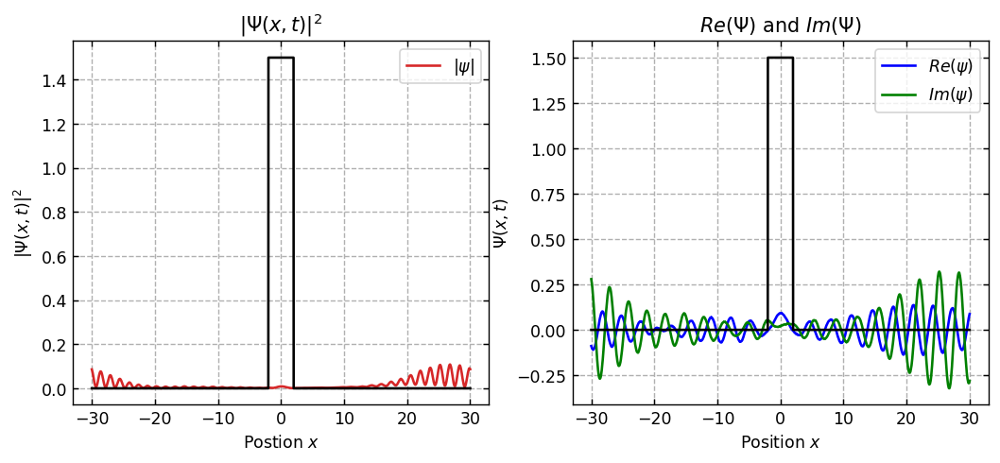

In [3]:
fig, ax1 = plt.subplots(1, 2, figsize=(10,4))

#Plotter:
plt.sca(ax1[0])
plt.plot(x,norm_psi, ls = '-', color = 'tab:red', label=r'$|\psi|$')
plt.plot(x, V, color='k')
plt.grid(ls='--')
plt.xlabel('Postion $x$')
plt.ylabel('$|\Psi(x,t)|^2$')
plt.title('$|\Psi(x,t)|^2$')
plt.tick_params(direction = 'in', top = True, right = True)
plt.legend()

#real og imaginær
plt.sca(ax1[1])
real = np.real(psi_x_ny)
imag = np.imag(psi_x_ny)
plt.plot(x,real, color = 'blue', label = '$Re(\psi)$')
plt.plot(x,imag, color = 'green', label = '$Im(\psi)$')
plt.plot(x, V, color='k')
plt.grid(ls='--')
plt.xlabel('Position $x$')
plt.ylabel('$\Psi(x,t)$')
plt.title('$Re(\Psi)$ and $Im(\Psi)$')
plt.tick_params(direction = 'in', top = True, right = True)
plt.legend()

C:\Users\laura\anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
Animation size has reached 21062226 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


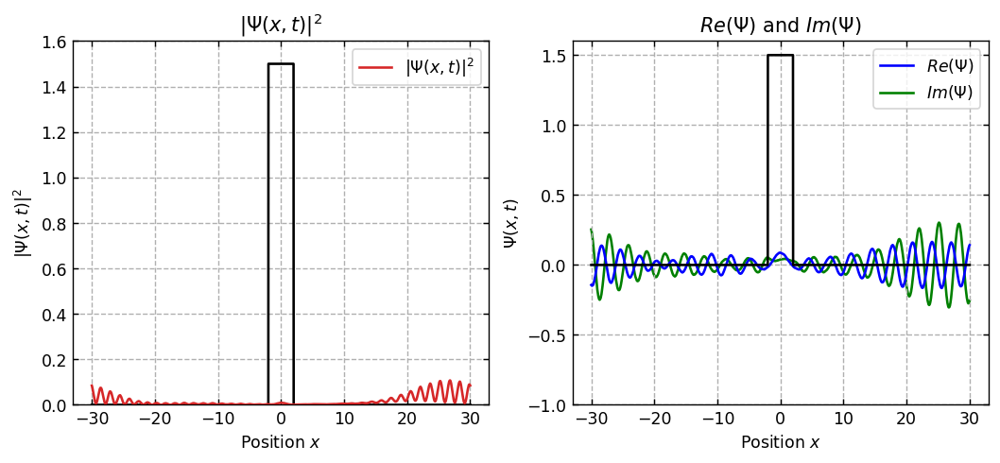

In [4]:
#Animation
fig, ax2 = plt.subplots(1, 2, figsize=(10,4))

plt.sca(ax2[0])
plt.grid(ls='--')
plt.xlabel('Position $x$')
plt.ylabel('$|\Psi(x,t)|^2$')
plt.title('$|\Psi(x,t)|^2$')
plt.tick_params(direction = 'in', top = True, right = True)
plt.ylim([0, V0+0.1])
line = plt.plot(x, norm_psi, ls = '-', color = 'tab:red', label = '$|\Psi(x,t)|^2$', zorder=3)
plt.plot(x, V, color='k')
plt.legend()

plt.sca(ax2[1])
plt.grid(ls='--')
plt.xlabel('Position $x$')
plt.ylabel('$\Psi(x,t)$')
plt.title('$Re(\Psi)$ and $Im(\Psi)$')
plt.tick_params(direction = 'in', top = True, right = True)
plt.ylim([-1, V0+0.1])
linereal = plt.plot(x, real, ls = '-', color = 'blue', label = '$Re(\Psi)$', ms=2, zorder=2)
lineimag = plt.plot(x, imag, ls = '-', color = 'green', label = '$Im(\Psi)$', ms=2, zorder=1)
plt.plot(x, V, color='k')
plt.legend()

def update(i):
    t = ts[i]
    y = abs(np.conj(saved_steps)[i]*saved_steps[i])
    linereal[0].set_data(x,np.real(saved_steps[i]))
    lineimag[0].set_data(x,np.imag(saved_steps[i]))
    line[0].set_data(x, y)
    return line[0], linereal[0], lineimag[0]

from matplotlib import animation
plt.rc('animation', html = 'jshtml')
N = len(saved_steps)

anim = animation.FuncAnimation(fig,
                               update,
                               frames=N,
                               interval=50,
                               blit=True)
anim